<a href="https://colab.research.google.com/github/Jecoc907/LA-Airbnb-Market-Analysis-in-Covid-19-Period/blob/main/LA_Airbnb_Market_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **LA Airbnb Market Analysis(pre- vs covid-19 period)**


## **Data Cleaning**
#### - This is to clean the database by dropping unnecessary columns and filtering 2018~2021

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.api as sm
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

In [2]:
from google.colab import drive

In [3]:
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
fulldf = pd.read_csv('/content/drive/MyDrive/DSO 574/Assignment 1/Combined Listing Data [Summary].csv')

<ipython-input-4-4a32d2f7a216>:1: DtypeWarning: Columns (5) have mixed types. Specify dtype option on import or set low_memory=False.
  fulldf = pd.read_csv('/content/drive/MyDrive/DSO 574/Assignment 1/Combined Listing Data [Summary].csv')


In [5]:
## add Year and Month Columns
fulldf['Year'] = list(fulldf['Scrape File'].str.split('_').str.get(2))
fulldf['Year'] = pd.to_numeric(fulldf['Year'], errors='coerce')

fulldf['Month'] = list(fulldf['Scrape File'].str.split('_').str.get(3))
fulldf['Month'] = pd.to_numeric(fulldf['Month'], errors='coerce')

In [6]:
# Add a Column with YYYY-MM format timeframe
fulldf['Year and Month'] = pd.to_datetime(fulldf['Year'].astype(str) + '-' + fulldf['Month'].astype(str), format='%Y-%m')

In [7]:
fulldf = fulldf[fulldf['Year and Month'] >= '2018-01-01']

In [8]:
## remove zero price listing
fulldf = fulldf[fulldf["price"] != 0]

In [9]:
fulldf.shape

(1389007, 21)

In [10]:
fulldf['room_type'].value_counts()

Entire home/apt    868605
Private room       460816
Shared room         55827
Hotel room           3759
Name: room_type, dtype: int64

In [11]:
## Group data into two groups: Pre-covid (2018.12 - 2019.12) and covid (2020.1 - 2021.1)
year_2018 = fulldf[(fulldf["Year"] == 2018) & (fulldf["Month"] == 12)]
year_2019 = fulldf[fulldf["Year"] == 2019]

In [12]:
pre_covid_years = pd.concat([year_2018, year_2019], ignore_index=True)

In [13]:
covid_years = fulldf[fulldf["Year"].between(2020, 2021)]

## **Data Visualization**

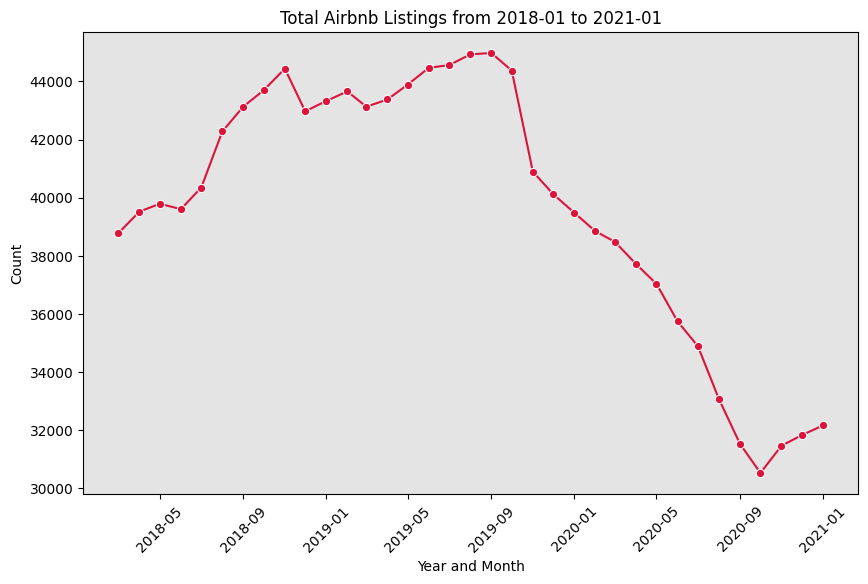

In [14]:
plt.figure(figsize=(10, 6))

sns.set_style(rc = {'axes.facecolor': '#e4e4e4'})

# Calculate the count of 'Entire home/apt' listings per year and month
count_all_type = fulldf.groupby('Year and Month').size()

# Reset index to make 'Year and Month' a regular column
count_all_type = count_all_type.reset_index(name='Count')

# Plot the scatter plot
sns.lineplot(data = count_all_type, x='Year and Month', y='Count', color='crimson', marker='o')

plt.title("Total Airbnb Listings from 2018-01 to 2021-01")
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
plt.show()

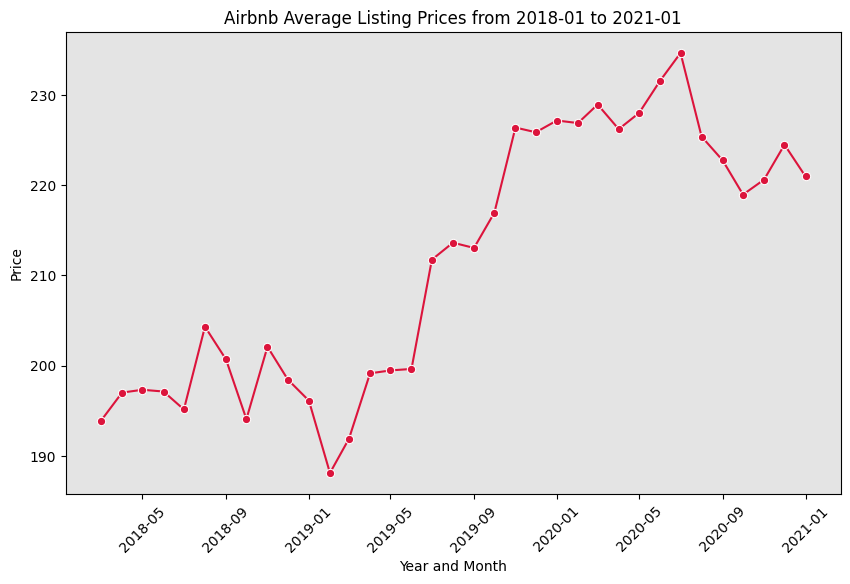

In [15]:
plt.figure(figsize=(10, 6))

sns.set_style(rc = {'axes.facecolor': '#e4e4e4'})

# Calculate the avg prices of listings per year and month
price_all_type = fulldf.groupby('Year and Month')['price'].mean()

# Reset index to make 'Year and Month' a regular column
price_all_type = price_all_type.reset_index(name='Price')

# Plot the scatter plot
sns.lineplot(data = price_all_type, x='Year and Month', y='Price', color = 'crimson', marker='o')

plt.title("Airbnb Average Listing Prices from 2018-01 to 2021-01")
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
plt.show()

In [16]:
# Calculate the count of 'Entire home/apt' listings per year and month
count_entire_home = fulldf[fulldf['room_type']=='Entire home/apt'].groupby('Year and Month').size()
count_entire_home = count_entire_home.reset_index(name='Count')

# Repeat the same steps for other room types
count_private_room = fulldf[fulldf['room_type']=='Private room'].groupby('Year and Month').size()
count_private_room = count_private_room.reset_index(name='Count')

count_shared_room = fulldf[fulldf['room_type']=='Shared room'].groupby('Year and Month').size()
count_shared_room = count_shared_room.reset_index(name='Count')

count_hotel_room = fulldf[fulldf['room_type'] == 'Hotel room'].groupby('Year and Month').size()
count_hotel_room = count_hotel_room.reset_index(name='Count')

# Calculate the avg prices of 'Entire home/apt' listings per year and month
price_entire_home = fulldf[fulldf['room_type']=='Entire home/apt'].groupby('Year and Month')['price'].mean()
price_entire_home = price_entire_home.reset_index(name='Price')

# Repeat the same steps for other room types
price_private_room = fulldf[fulldf['room_type']=='Private room'].groupby('Year and Month')['price'].mean()
price_private_room = price_private_room.reset_index(name='Price')

price_shared_room = fulldf[fulldf['room_type']=='Shared room'].groupby('Year and Month')['price'].mean()
price_shared_room = price_shared_room.reset_index(name='Price')

price_hotel_room = fulldf[fulldf['room_type']=='Hotel room'].groupby('Year and Month')['price'].mean()
price_hotel_room = price_hotel_room.reset_index(name='Price')

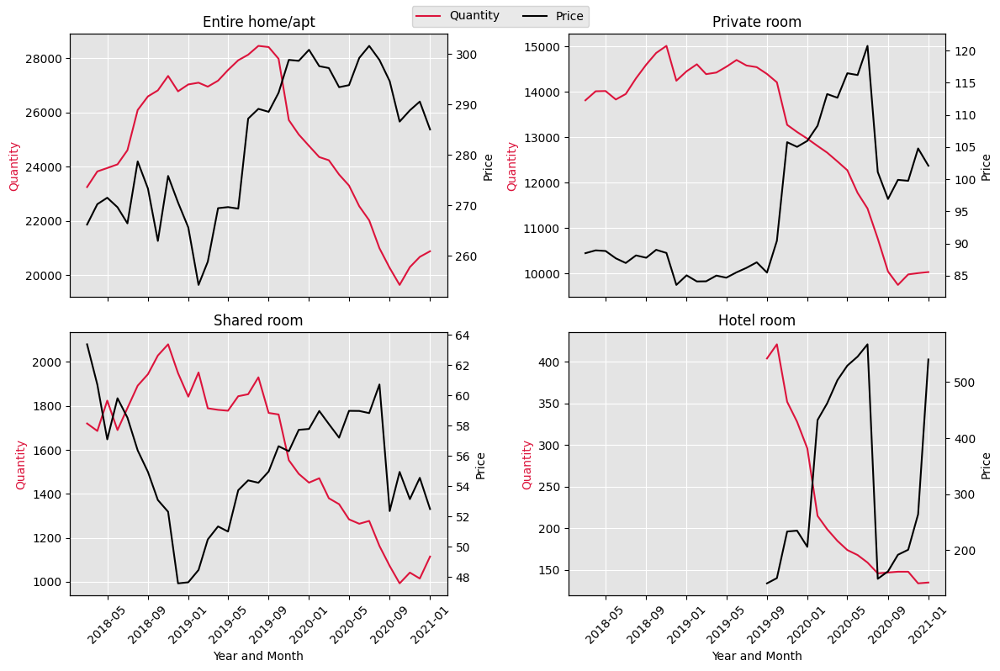

In [17]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12, 8), sharex=True)

sns.set_style(rc = {'axes.facecolor': '#e4e4e4'})

# Plot Quantity
sns.lineplot(data=count_entire_home, x='Year and Month', y='Count', label='Quantity', ax=axes[0, 0], color='crimson', legend= False)
sns.lineplot(data=count_private_room, x='Year and Month', y='Count', label='Quantity', ax=axes[0, 1], color='crimson', legend= False)
sns.lineplot(data=count_shared_room, x='Year and Month', y='Count', label='Quantity', ax=axes[1, 0], color='crimson', legend= False)
sns.lineplot(data=count_hotel_room, x='Year and Month', y='Count', label='Quantity', ax=axes[1, 1], color='crimson', legend= False)

# Plot Price on a separate y-axis
ax_price_entire_home = axes[0, 0].twinx()
ax_price_private_room = axes[0, 1].twinx()
ax_price_shared_room = axes[1, 0].twinx()
ax_price_hotel_room = axes[1, 1].twinx()

# Plot Price
sns.lineplot(data=price_entire_home, x='Year and Month', y='Price', label='Price', ax=ax_price_entire_home, color='black', legend= False)
sns.lineplot(data=price_private_room, x='Year and Month', y='Price', label='Price', ax=ax_price_private_room, color='black', legend= False)
sns.lineplot(data=price_shared_room, x='Year and Month', y='Price', label='Price', ax=ax_price_shared_room, color='black', legend= False)
sns.lineplot(data=price_hotel_room, x='Year and Month', y='Price', label='Price', ax=ax_price_hotel_room, color='black', legend= False)

# Set titles for each subplot
axes[0, 0].set_title('Entire home/apt')
axes[0, 1].set_title('Private room')
axes[1, 0].set_title('Shared room')
axes[1, 1].set_title('Hotel room')

# # Set legends with appropriate labels
# axes[0, 0].legend(['Quantity'], loc='upper left')
# ax_price_entire_home.legend(['Price'], loc='upper left')


# Set y-axis label colors
axes[0, 0].set_ylabel('Quantity', color='crimson')
ax_price_entire_home.set_ylabel('Price', color='black')

axes[0, 1].set_ylabel('Quantity', color='crimson')
ax_price_private_room.set_ylabel('Price', color='black')

axes[1, 0].set_ylabel('Quantity', color='crimson')
ax_price_shared_room.set_ylabel('Price', color='black')

axes[1, 1].set_ylabel('Quantity', color='crimson')
ax_price_hotel_room.set_ylabel('Price', color='black')

# Rotate x-axis labels for better visibility
for ax in axes.flat:
    ax.tick_params(axis='x', rotation=45)

# Adjust layout
plt.tight_layout()

#Grid
axes[0, 0].grid(True, color='white')
axes[0, 1].grid(True, color='white')
axes[1, 0].grid(True, color='white')
axes[1, 1].grid(True, color='white')

handles1, labels1 = axes[0, 0].get_legend_handles_labels()
handles2, labels2 = ax_price_entire_home.get_legend_handles_labels()
fig.legend(handles1 + handles2, labels1 + labels2, loc='upper center', ncol=2)

# Display the plot
plt.show()

##**Data Visualization By Latitude and Longitude**

In [18]:
# Keep the unique value for each ID(listing) and save it as a new dataset
pre_covid_years_unique = pre_covid_years.drop_duplicates(subset=['id'])
covid_years_unique = covid_years.drop_duplicates(subset=['id'])

In [19]:
# Check the counties
county = pd.DataFrame(pre_covid_years_unique['neighbourhood'].unique()).sort_values(0)
county

,0
238,Acton
118,Adams-Normandie
117,Agoura Hills
81,Agua Dulce
113,Alhambra
...,...
182,Willowbrook
210,Wilmington
106,Windsor Square
122,Winnetka


### Pre covid year

In [20]:
import folium
from folium.plugins import MarkerCluster

# Create a base map centered at Los Angeles
map_center = [34.0522, -118.2437]
pre_covid_year_map = folium.Map(location=map_center, zoom_start=12)

# Create a MarkerCluster to add multiple markers efficiently
marker_cluster = MarkerCluster().add_to(pre_covid_year_map)

# Add markers for each latitude and longitude in your DataFrame
for index, row in pre_covid_years_unique.iterrows():
    folium.Marker([row['latitude'], row['longitude']]).add_to(marker_cluster)

# Save the map to an HTML file or display it
# my_map.save('my_map.html')
# or
pre_covid_year_map

###Post Covid year

In [21]:
# Create a base map centered at Los Angeles
map_center = [34.0522, -118.2437]
covid_year_map = folium.Map(location=map_center, zoom_start=12)

# Create a MarkerCluster to add multiple markers efficiently
marker_cluster = MarkerCluster().add_to(covid_year_map)

# Add markers for each latitude and longitude in your DataFrame
for index, row in covid_years_unique.iterrows():
    folium.Marker([row['latitude'], row['longitude']]).add_to(marker_cluster)

# Save the map to an HTML file or display it
# my_map.save('my_map.html')
# or
covid_year_map

#### Build a table for changes in meidan price by geo - pre COVID versus During COVID

In [22]:
from prettytable import PrettyTable

# Specify the Column Names while initializing the Table
myTable = PrettyTable(["Area / Period", "Median Price Before COVID", "Median Price During COVID", "Percentage delta"])

# Add rows
myTable.add_row(["Hollywood", "$125", "$128", "2.40 %"])
myTable.add_row(["Santa Monica", "$150", "$150", "0.00 %"])
myTable.add_row(["Hermosa_Beach", "$150", "$160", "6.67 %"])
myTable.add_row(["Long Beach", "$100", "$100", "0.00 %"])
myTable.add_row(["Los Angeles", "$115", "$130", "13.04 %"])
myTable.add_row(["Pasadena, Glendaale", "$110", "$125", "13.63 %"])
myTable.add_row(["San Fernando Valley", "$75", "$80", "6.67 %"])

print(myTable)

# Create a separate table for notes
notesTable = PrettyTable()
notesTable.field_names = ["Notes"]

# Add a row to the notes table
notesTable.add_row(["The reported average prices per area are calculated as the median   "])
notesTable.add_row(["values across three counties within each specified area."])

# Print the notes table
print(notesTable)

+---------------------+---------------------------+---------------------------+------------------+
|    Area / Period    | Median Price Before COVID | Median Price During COVID | Percentage delta |
+---------------------+---------------------------+---------------------------+------------------+
|      Hollywood      |            $125           |            $128           |      2.40 %      |
|     Santa Monica    |            $150           |            $150           |      0.00 %      |
|    Hermosa_Beach    |            $150           |            $160           |      6.67 %      |
|      Long Beach     |            $100           |            $100           |      0.00 %      |
|     Los Angeles     |            $115           |            $130           |     13.04 %      |
| Pasadena, Glendaale |            $110           |            $125           |     13.63 %      |
| San Fernando Valley |            $75            |            $80            |      6.67 %      |
+---------

In [23]:
# For reference - The composition of each area
Hollywood = pre_covid_years_unique[(pre_covid_years_unique['neighbourhood'] == 'Hollywood') | (pre_covid_years_unique['neighbourhood'] == 'Beverly Hills') | (pre_covid_years_unique['neighbourhood'] == 'West Hollywood')]['price'].median()
Santa_Monica = pre_covid_years_unique[(pre_covid_years_unique['neighbourhood'] == 'Venice') | (pre_covid_years_unique['neighbourhood'] == 'Santa Monica') | (pre_covid_years_unique['neighbourhood'] == 'Sawtelle')]['price'].median()
Hermosa_Beach = pre_covid_years_unique[(pre_covid_years_unique['neighbourhood'] == 'Hermosa Beach') | (pre_covid_years_unique['neighbourhood'] == 'Manhattan Beach') | (pre_covid_years_unique['neighbourhood'] == 'Redondo Beach')]['price'].median()
Long_Beach = pre_covid_years_unique[(pre_covid_years_unique['neighbourhood'] == 'Long Beach') | (pre_covid_years_unique['neighbourhood'] == 'Signal Hill') ]['price'].median()
Los_Angeles = pre_covid_years_unique[(pre_covid_years_unique['neighbourhood'] == 'Koreatown') | (pre_covid_years_unique['neighbourhood'] == 'Downtown') | (pre_covid_years_unique['neighbourhood'] == 'Westlake')]['price'].median()
Pasadena_Glendaale = pre_covid_years_unique[(pre_covid_years_unique['neighbourhood'] == 'Pasadena') | (pre_covid_years_unique['neighbourhood'] == 'South Pasadena') | (pre_covid_years_unique['neighbourhood'] == 'Glendale')]['price'].median()
San_Fernando_Valley = pre_covid_years_unique[(pre_covid_years_unique['neighbourhood'] == 'North Hills') | (pre_covid_years_unique['neighbourhood'] == 'San Fernando') | (pre_covid_years_unique['neighbourhood'] == 'Northridge')]['price'].median()

In [24]:
print(Hollywood, Santa_Monica, Hermosa_Beach, Long_Beach, Los_Angeles, Pasadena_Glendaale, San_Fernando_Valley)

125.0 150.0 150.0 100.0 115.0 110.0 75.0
